In [27]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append('../../../')

# Custom modules
from main import load_and_prepare_sessions
from processing.session_sampling import MiceAnalysis
from data.mouse import create_mice_dict
from analysis.timepoint_analysis import sample_signals_and_metrics, collect_sessions_data

# Config and constants
from config import all_event_types, all_brain_regions
import config

# Plotting libraries
import matplotlib.pyplot as plt

# Signal processing and statistical tools
from scipy.signal import savgol_filter
import scipy.stats as stats
from itertools import product

# Utility libraries
import numpy as np
from tqdm.notebook import tqdm
from ipywidgets import FloatProgress
from collections import defaultdict

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [28]:
# for stage in ['stage1', 'stage2', 'stage3', 'stage4']:
#     for phase in ['pre', 'post']:
#         curr_sessions = load_and_prepare_sessions("../../../../Gq-DREADD_CPT_Training_Stages", load_from_pickle=True, remove_bad_signal_sessions=True,
#                                                   pickle_name=f'sessions_{stage}_{phase}')
        #title = stage + ' ' + phase
        # for session in tqdm(curr_sessions):
        #     for brain_reg in session.brain_regions:
        #         pass
                # # Step 3: Create a Plotly figure object for subplots
                # # Adjust rows and cols based on your layout needs
                # fig = make_subplots(rows=1, cols=1)

                # title = f"genotype: {session.genotype}, dose: {session.drug_info['dose']}, brain region: {brain_reg}\
                #     \n{session.trial_id}, {stage}, {phase}"
                # plot_session_events_and_signal(session, brain_reg, fig, row=1, col=1, title_suffix=title)
                # #fig.write_image(f"{session.mouse_id}_{session.trial_id}_{brain_reg}.png")
                # #fig.show()

                # #fig = make_subplots(rows=1, cols=1)

                # #plot_session_events_and_signal(session, brain_reg, fig, row=1, col=1, title_suffix=title, smooth=True)
                # #fig.write_image(f"{session.mouse_id}_{session.trial_id}_{brain_reg}.png")
                # curr_fname = f"{session.mouse_id}_{session.trial_id}_{brain_reg}_{stage}_{phase}.html"
                # print(curr_fname)
                # fig.write_html(curr_fname)
                
    


In [29]:
first_mice_sessions = load_and_prepare_sessions("../../../../Gq-DREADD_CPT_Training_Stages", load_from_pickle=True, remove_bad_signal_sessions=True,
                                                pickle_name=f'sessions_stage1_pre')
first_mice_ids = [s.mouse_id for s in first_mice_sessions]

In [30]:
brain_reg_to_color = {'LH': 'orange',
                      'mPFC': 'cornflowerblue'}

In [31]:
from collections import defaultdict

# Step 1: Load and Group Signals
signals_grouped = defaultdict(dict)

# Define the stages and phases
stages = ['stage1', 'stage2', 'stage3', 'stage4']
phases = ['pre', 'post']

for stage in stages:
    # Temporary storage for sessions in each phase
    phase_sessions = {}
    
    # Step 1: Load all sessions for the current stage across all phases
    for phase in phases:
        pickle_name = f'sessions_two_{stage}_{phase}'
        
        # Load and prepare sessions
        sessions = load_and_prepare_sessions(
            "../../../../Gq-DREADD_CPT_Training_Stages",
            load_from_pickle=True,
            remove_bad_signal_sessions=True,
            pickle_name=pickle_name
        )
        
        # Store sessions by phase
        phase_sessions[phase] = sessions
    
    # Step 2: Compute the intersection of mouse IDs across phases
    mouse_ids_pre = set(s.mouse_id for s in phase_sessions['pre'])
    mouse_ids_post = set(s.mouse_id for s in phase_sessions['post'])
    intersection_mouse_ids = mouse_ids_pre.intersection(mouse_ids_post)
    
    # Optional: Log the number of common mouse IDs
    print(f"[INFO] {stage}: {len(intersection_mouse_ids)} common mouse IDs across phases.")
    
    # Step 3: Iterate over each phase and filter sessions by the intersection of mouse IDs
    for phase in phases:
        # Retrieve the sessions for the current phase
        sessions = phase_sessions[phase]
        
        # Filter sessions to include only those with mouse IDs in the intersection
        filtered_sessions = [s for s in sessions if s.mouse_id in intersection_mouse_ids]
        
        # Optional: Log the number of sessions after filtering
        print(f"[INFO] {stage} - {phase}: {len(filtered_sessions)} sessions after filtering.")
        
        # Step 4: Process the filtered sessions
        for event in all_event_types:
            for brain_reg in all_brain_regions:
                key = (event, brain_reg)
                sampled = sample_signals_and_metrics(
                    filtered_sessions, 
                    event, 
                    brain_reg, 
                    weight_method='mice'
                )
                
                # Check if sampling was successful
                if sampled:
                    all_signals = sampled[0]
                    
                    # Group the signals by event, brain region, stage, and phase
                    signals_grouped[key][(stage, phase)] = all_signals
                    
                    other_phase = 'post' if phase == 'pre' else 'pre'
                    other_phase_key = (stage, other_phase)
                    # if other_phase_key in signals_grouped[key]:
                    #     # Both phases exist for this key and stage
                    #     signals_current = signals_grouped[key][(stage, phase)]
                    #     signals_other = signals_grouped[key][other_phase_key]

                    #     len_current = len(signals_current)
                    #     len_other = len(signals_other)
                    #     min_len = min(len_current, len_other)

                    #     # Sample min_len signals from both arrays
                    #     indices_current = np.random.choice(len_current, size=min_len, replace=False)
                    #     indices_other = np.random.choice(len_other, size=min_len, replace=False)
                    #     signals_grouped[key][(stage, phase)] = signals_current[indices_current]
                    #     signals_grouped[key][other_phase_key] = signals_other[indices_other]

# Optional: Inspect the grouped signals
# for key, stages_phases in signals_grouped.items():
#     print(f"Event-BrainRegion: {key}")
#     for stage_phase, signals in stages_phases.items():
#         print(f"  {stage_phase}: {len(signals)} signals")

[INFO] stage1: 7 common mouse IDs across phases.
[INFO] stage1 - pre: 7 sessions after filtering.
[INFO] stage1 - post: 7 sessions after filtering.
[INFO] stage2: 13 common mouse IDs across phases.
[INFO] stage2 - pre: 15 sessions after filtering.
[INFO] stage2 - post: 13 sessions after filtering.
[INFO] stage3: 20 common mouse IDs across phases.
[INFO] stage3 - pre: 20 sessions after filtering.
[INFO] stage3 - post: 20 sessions after filtering.
[INFO] stage4: 6 common mouse IDs across phases.
[INFO] stage4 - pre: 6 sessions after filtering.
[INFO] stage4 - post: 6 sessions after filtering.


In [32]:
def preprocess_and_plot_signals(all_signals, event_type, brain_region, smoothing_len=10, title_suffix=None):
    # Assuming all_signals is predefined
    signals = all_signals

    interval_start = config.peak_interval_config["interval_start"]
    interval_end = config.peak_interval_config["interval_end"]
    fps = config.PLOTTING_CONFIG['fps']
    
    xs = np.arange(-interval_start, interval_end) / fps
    
    # Smooth the mean signal
    ys = np.mean(signals, axis=0)
    window = np.ones(smoothing_len) / smoothing_len
    ys = np.convolve(ys, window, 'same')

    # Calculate the standard deviation of the mean
    std_signal = np.std(signals, axis=0) / np.sqrt(len(signals))

    # Use scipy.stats.norm.interval to get the 95% confidence interval
    alpha = 0.95
    ci_lower, ci_upper = stats.norm.interval(alpha, loc=ys, scale=std_signal)

    # The lower and upper bounds
    lb = ci_lower.min()
    ub = ci_upper.max()

    ylim = (lb, ub)
    
    # Assuming brain_reg_to_color is predefined
    color = brain_reg_to_color[brain_region]

    if title_suffix is None:
        title_suffix = ''
    plt.figure(dpi=300)
    plt.plot(xs, ys, color=color, label='Mean Signal')
    plt.fill_between(xs, ci_lower, ci_upper, color=color, alpha=0.2, label='95% CI')
    plt.ylim(ylim)
    title_name = f'{event_type}, {brain_region}, {title_suffix}, (n = {len(signals)})'
    plt.title(title_name)
    plt.xlabel('Time (s)')
    plt.ylabel('z-score')
    plt.legend()
    plt.grid()
    # plt.savefig(title_name)
    plt.show()

In [33]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats

def preprocess_and_plot_signals(all_signals, event_type, brain_region, smoothing_len=10, title_suffix=None, ax=None):
    """
    Preprocess and plot signals on the given Axes.

    Parameters:
    - all_signals: numpy array of signals
    - event_type: string indicating the event type
    - brain_region: string indicating the brain region
    - smoothing_len: integer for smoothing window length
    - title_suffix: additional string for the plot title
    - ax: matplotlib Axes object to plot on
    """
    if ax is None:
        fig, ax = plt.subplots(dpi=300)

    signals = all_signals

    interval_start = config.peak_interval_config["interval_start"]
    interval_end = config.peak_interval_config["interval_end"]
    fps = config.PLOTTING_CONFIG['fps']

    xs = np.arange(-interval_start, interval_end) / fps

    # Smooth the mean signal
    ys = np.mean(signals, axis=0)
    window = np.ones(smoothing_len) / smoothing_len
    ys = np.convolve(ys, window, 'same')

    # Calculate the standard deviation of the mean
    std_signal = np.std(signals, axis=0) / np.sqrt(len(signals))

    # Use scipy.stats.norm.interval to get the 95% confidence interval
    alpha = 0.95
    ci_lower, ci_upper = stats.norm.interval(alpha, loc=ys, scale=std_signal)

    # Assuming brain_reg_to_color is predefined
    color = brain_reg_to_color.get(brain_region, 'blue')  # Default to 'blue' if not found

    if title_suffix is None:
        title_suffix = ''
    
    ax.plot(xs, ys, color=color, label='Mean Signal')
    ax.fill_between(xs, ci_lower, ci_upper, color=color, alpha=0.2, label='95% CI')
    
    title_name = f'{event_type}, {brain_region}, {title_suffix}, (n = {len(signals)})'
    ax.set_title(title_name, fontsize=10)
    ax.set_xlabel('Time (s)', fontsize=8)
    ax.set_ylabel('z-score', fontsize=8)
    ax.legend(fontsize=6)
    ax.grid(True)

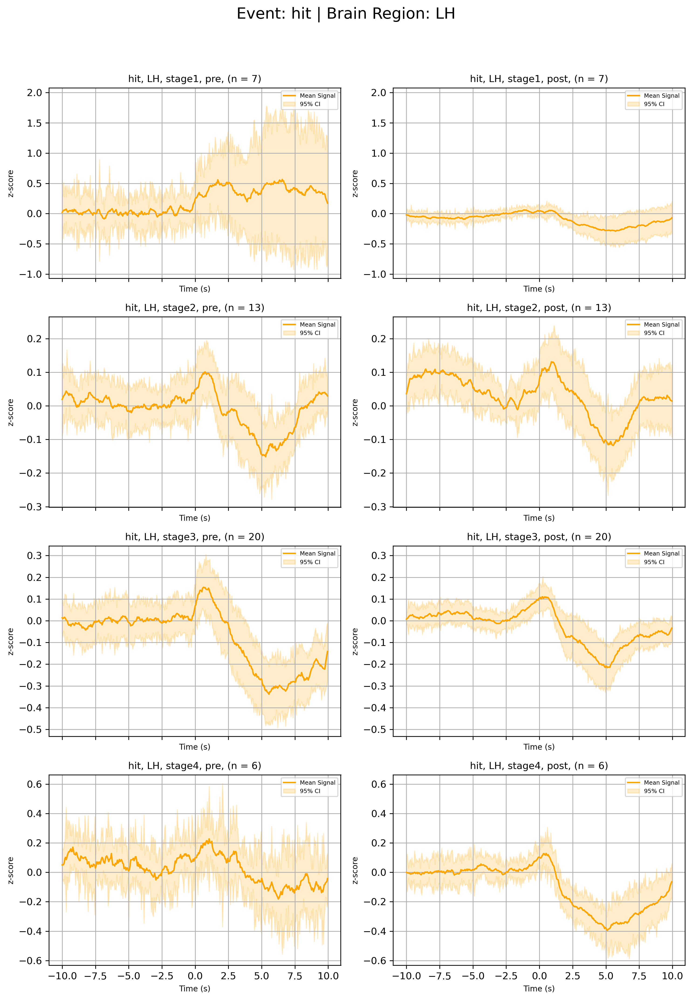

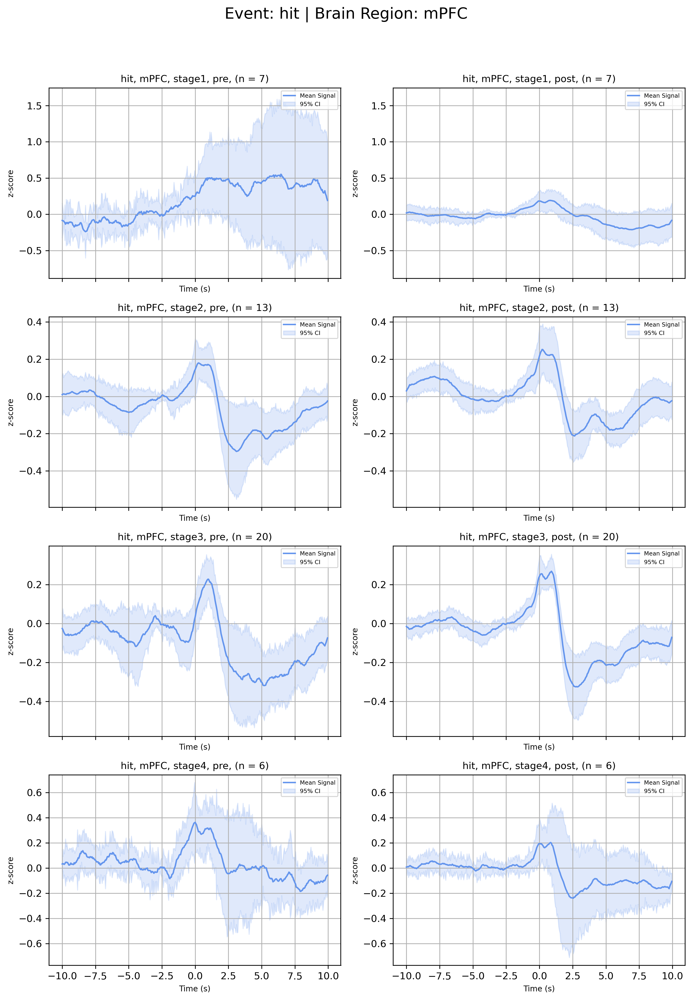

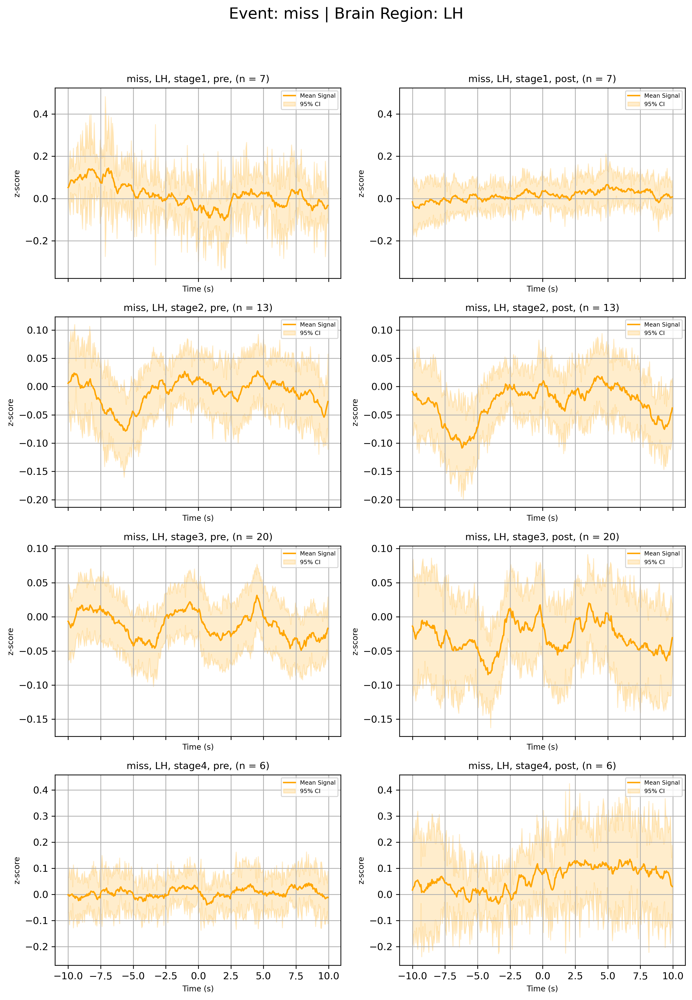

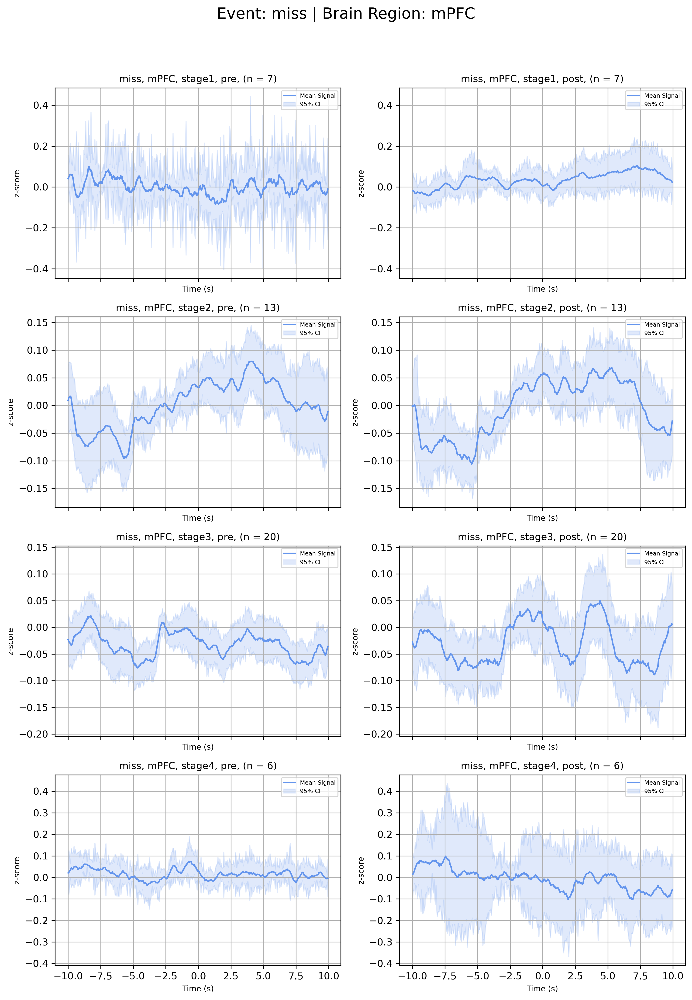

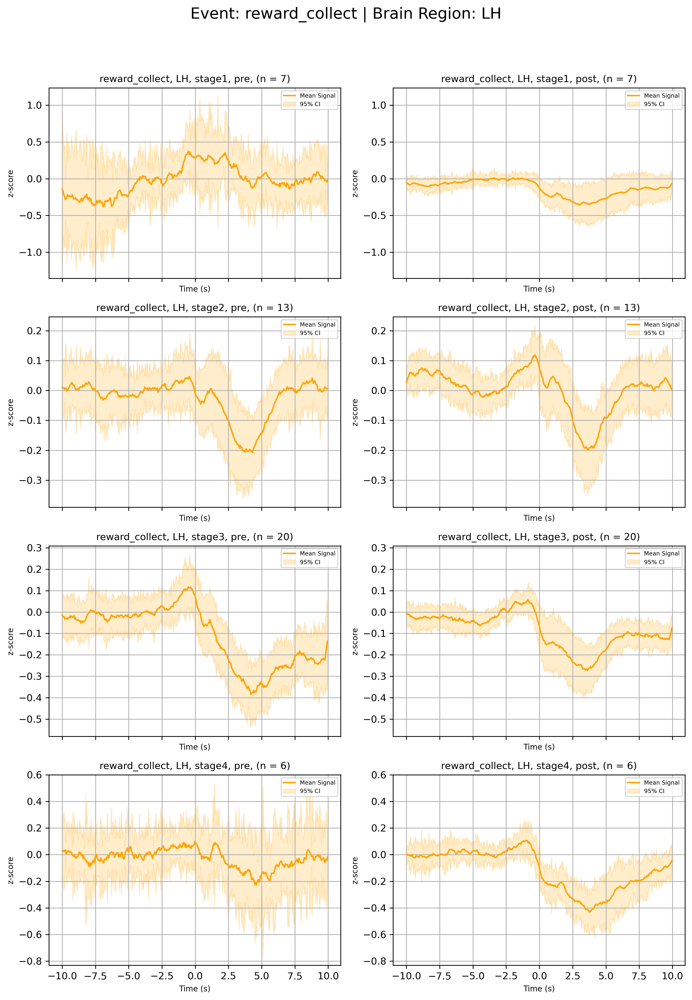

...

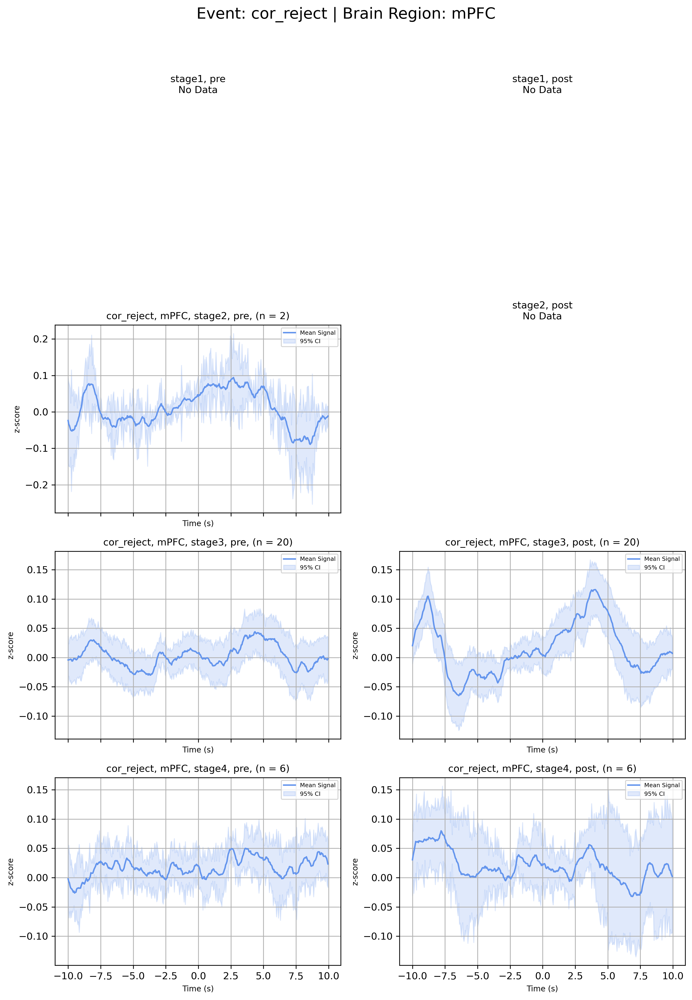

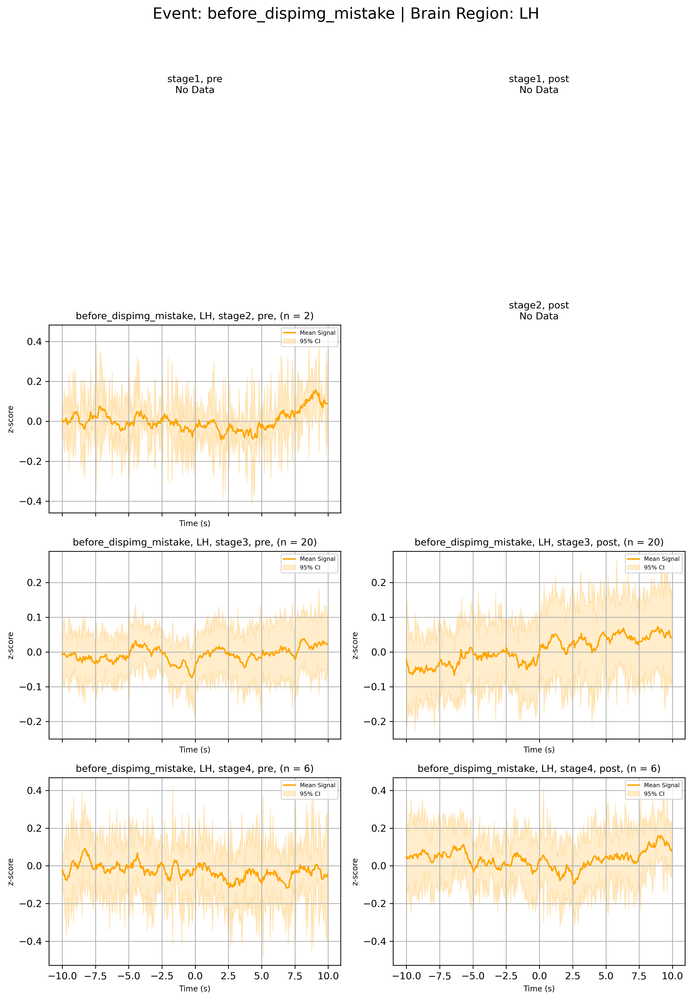

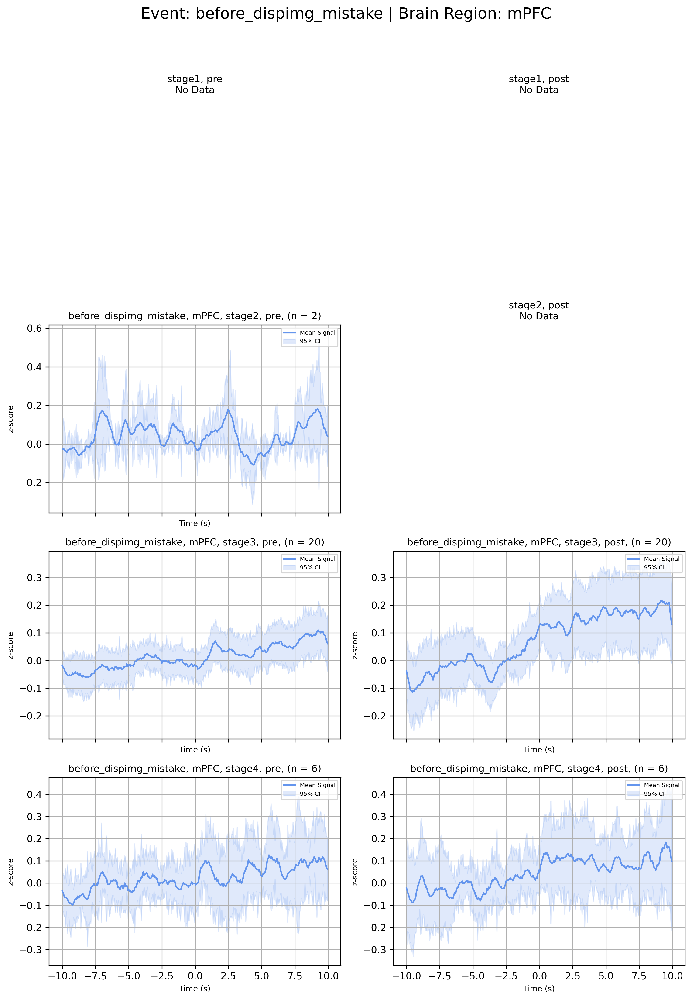

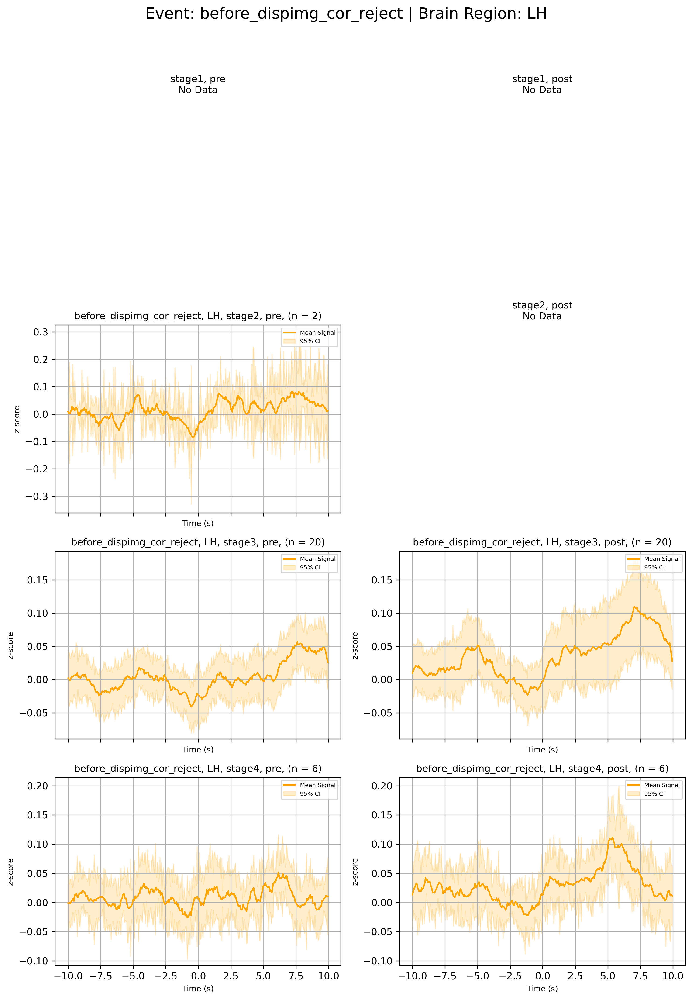

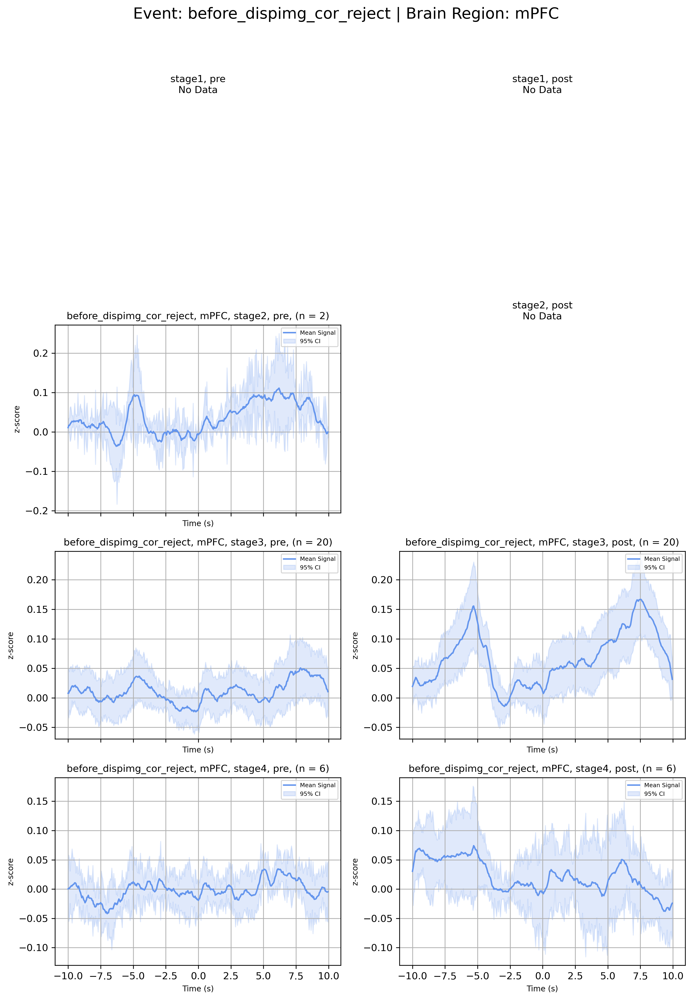

In [34]:
sync_y_limits = 'row'  # Options: 'global', 'row'

# Step 3: Create and Plot Figures
for (event, brain_reg), stage_phase_signals in signals_grouped.items():
    # Create a figure with 4 rows (stages) and 2 columns (phases)
    fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(10, 15), dpi=300, sharex=True, sharey=False)
    fig.suptitle(f'Event: {event} | Brain Region: {brain_reg}', fontsize=16)
    
    # Initialize lists to store y-limits
    if sync_y_limits == 'global':
        all_y_mins = []
        all_y_maxs = []
    elif sync_y_limits == 'row':
        row_y_mins = [[] for _ in range(4)]  # One list per row
        row_y_maxs = [[] for _ in range(4)]
    else:
        raise ValueError("sync_y_limits must be either 'global' or 'row'")
    
    # Iterate through stages and phases
    for i, stage in enumerate(['stage1', 'stage2', 'stage3', 'stage4']):
        for j, phase in enumerate(['pre', 'post']):
            ax = axes[i][j]
            key = (stage, phase)
            if key in stage_phase_signals:
                all_signals = stage_phase_signals[key]
                title_suffix = f'{stage}, {phase}'
                preprocess_and_plot_signals(
                    all_signals,
                    event_type=event,
                    brain_region=brain_reg,
                    smoothing_len=10,
                    title_suffix=title_suffix,
                    ax=ax
                )
                # Get current y-limits
                current_ylim = ax.get_ylim()
                
                if sync_y_limits == 'global':
                    all_y_mins.append(current_ylim[0])
                    all_y_maxs.append(current_ylim[1])
                elif sync_y_limits == 'row':
                    row_y_mins[i].append(current_ylim[0])
                    row_y_maxs[i].append(current_ylim[1])
            else:
                ax.axis('off')  # Hide subplot if no data
                ax.set_title(f'{stage}, {phase}\nNo Data', fontsize=10)
    
    # Step 4: Synchronize Y-Axis Limits
    if sync_y_limits == 'global':
        if all_y_mins and all_y_maxs:
            global_min = min(all_y_mins)
            global_max = max(all_y_maxs)
            for ax in axes.flat:
                if ax.has_data():
                    ax.set_ylim(global_min, global_max)
    elif sync_y_limits == 'row':
        for row in range(4):
            if row_y_mins[row] and row_y_maxs[row]:
                row_min = min(row_y_mins[row])
                row_max = max(row_y_maxs[row])
                for col in range(2):
                    ax = axes[row][col]
                    if ax.has_data():
                        ax.set_ylim(row_min, row_max)
    
    # Step 5: Finalize and Show/Save the Figure
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust layout to accommodate the suptitle
    plt.show()
    # To save the figure instead of showing, uncomment the following line:
    fig.savefig(f'plot_event_{event}_brain_region_{brain_reg}_mice_agg.png')
    plt.close(fig)  # Close the figure to free memory


In [35]:
def session_br_event_count(session, br, event):
    total = 0
    maybe_signal_info = session.signal_info.get((br, event))
    if maybe_signal_info:
        total += maybe_signal_info['signal_matrix'].shape[0]
    return total


In [36]:
# Step 1: Load and Group Signals
signals_grouped = defaultdict(dict)

for stage in ['stage1', 'stage2', 'stage3', 'stage4']:
    for phase in ['pre', 'post']:
        pickle_name = f'sessions_two_{stage}_{phase}'
        curr_sessions = load_and_prepare_sessions(
            "../../../../Gq-DREADD_CPT_Training_Stages",
            load_from_pickle=True,
            remove_bad_signal_sessions=True,
            pickle_name=pickle_name
        )
        print(stage, phase, len(curr_sessions))
        # print(stage, phase, [(s.mouse_id, session_br_event_count(s, 'mPFC', 'dispimg')) for s in curr_sessions])
                              #if session_br_event_count(s, 'mPFC', 'dispimg') < 100])
        
        # # Filter sessions by mouse IDs
        # if stage == 'stage1':
        #     curr_sessions = [s for s in curr_sessions if s.mouse_id in first_mice_ids]
        
        # for event in all_event_types:
        #     for brain_reg in all_brain_regions:
        #         key = (event, brain_reg)
        #         if sample_signals_and_metrics(curr_sessions, event, brain_reg, weight_method='mice'):
        #             all_signals = sample_signals_and_metrics(curr_sessions, event, brain_reg, weight_method='mice')[0]
        #             signals_grouped[key][(stage, phase)] = all_signals

stage1 pre 8
stage1 post 23
stage2 pre 16
stage2 post 24
stage3 pre 23
stage3 post 21
stage4 pre 7
stage4 post 6
